In [ ]:
# @title SHOW PREVIEW OF VOICES {display-mode:"form"}
from IPython.display import Audio, display
import ipywidgets as widgets

AUDIO_URLS = {
    "alloy": "https://cdn.openai.com/API/docs/audio/alloy.wav",
    "echo": "https://cdn.openai.com/API/docs/audio/echo.wav",
    "fable": "https://cdn.openai.com/API/docs/audio/fable.wav",
    "onyx": "https://cdn.openai.com/API/docs/audio/onyx.wav",
    "nova": "https://cdn.openai.com/API/docs/audio/nova.wav",
    "shimmer": "https://cdn.openai.com/API/docs/audio/shimmer.wav"
}

for name, url in AUDIO_URLS.items():
    audio_widget = widgets.Audio(url=url, autoplay=False, controls=True)
    label = widgets.Label(f"{name.title()}", layout=widgets.Layout(width='55px', display='flex', align_items='center', justify_content='center'))
    hbox = widgets.HBox([label, audio_widget], layout=widgets.Layout(align_items='center'))
    display(hbox)

In [ ]:
# @title INITIALIZE OPENAI CLIENT {display-mode:"form"}
# @markdown Enter your [OpenAI API Key](https://platform.openai.com/api-keys)
OPENAI_API_KEY = '' # @param {type:"string"}

# INITIALIZE OPENAI CLIENT
%pip install -qqq --progress-bar off --no-cache-dir openai cohere tiktoken
import openai
client = openai.OpenAI(api_key=OPENAI_API_KEY)

In [ ]:
# @title SELECT VOICE {display-mode:"form"}
# @markdown Preview voices [here](https://platform.openai.com/docs/guides/text-to-speech). {display-mode:"form"}
VOICE = 'echo'  # @param ['alloy', 'echo', 'fable', 'onyx', 'nova', 'shimmer'] {type:"string"}

In [ ]:
# @title RUN TO PROMPT FOR POWERPOINT UPLOAD
# PROMPT FOR FILE UPLOAD
!rm -rf .assets
!rm -f *.pptx
print("Please upload a PowerPoint (.pptx) file.")
from google.colab import files
uploaded = files.upload()

# VALIDATE POWERPOINT FILE
assert len(uploaded) == 1, "Please upload exactly one PowerPoint (.pptx) file."
pptx_filename = list(uploaded.keys())[0]
assert pptx_filename.endswith('.pptx'), "The file must be a .pptx file."

# INITIALIZE DIRECTORIES
import os
assets_dir = ".assets"
images_dir = os.path.join(assets_dir, "images")
voiceovers_dir = os.path.join(assets_dir, "voiceovers")
videoclips_dir = os.path.join(assets_dir, "videoclips")
for directory in [assets_dir, images_dir, voiceovers_dir, videoclips_dir]:
    os.makedirs(directory, exist_ok=True)

# MOVE POWERPOINT TO ASSETS DIRECTORY
pptx_assets_dir = os.path.join(assets_dir, pptx_filename)
!mv "{pptx_filename}" "{pptx_assets_dir}"

# LOAD POWERPOINT
%pip install -qqq --progress-bar off --no-cache-dir python-pptx
from pptx import Presentation
presentation = Presentation(pptx_assets_dir)

Please upload a PowerPoint (.pptx) file.


Saving example.pptx to example.pptx


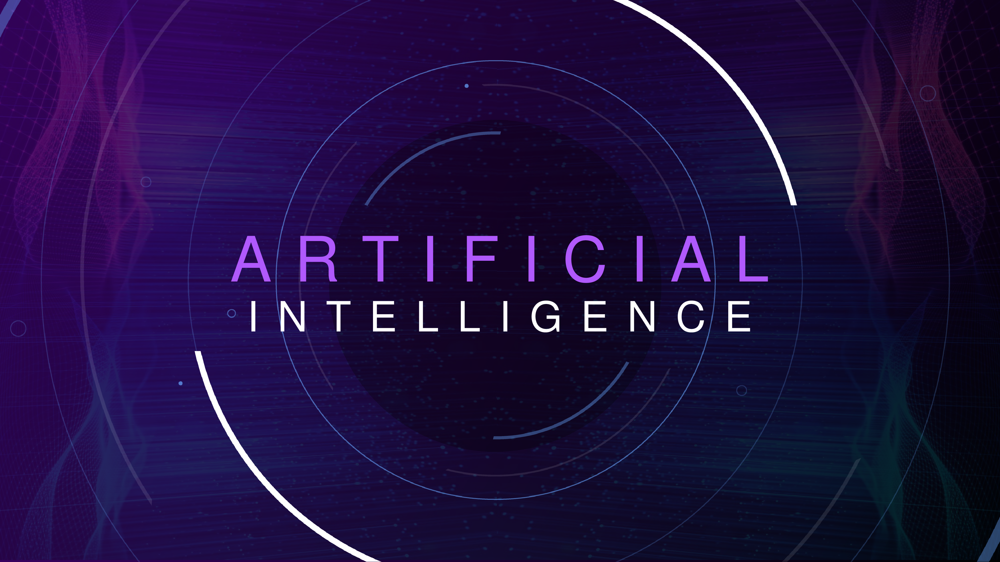

Let’s get started. In this presentation, we'll unravel the mysteries of AI, its
boundless possibilities, and the profound impact it holds over our tomorrow.




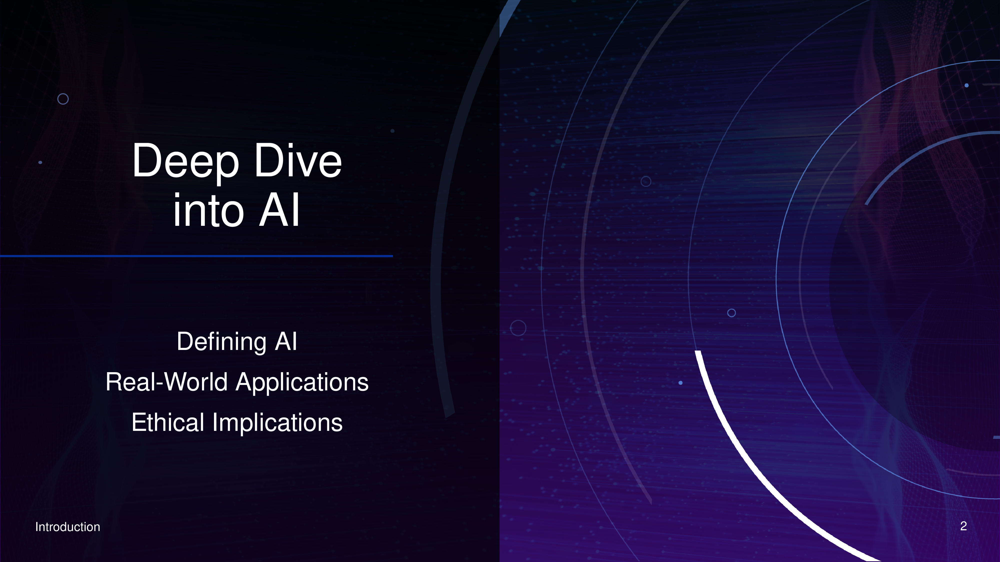

AI simulates human intelligence through algorithms learning from data, enabling
predictions, automation, and problem-solving. It's transforming daily life and
industries with smart tools and systems, while raising ethical questions about
responsibility and the protection of rights and freedoms as it evolves.




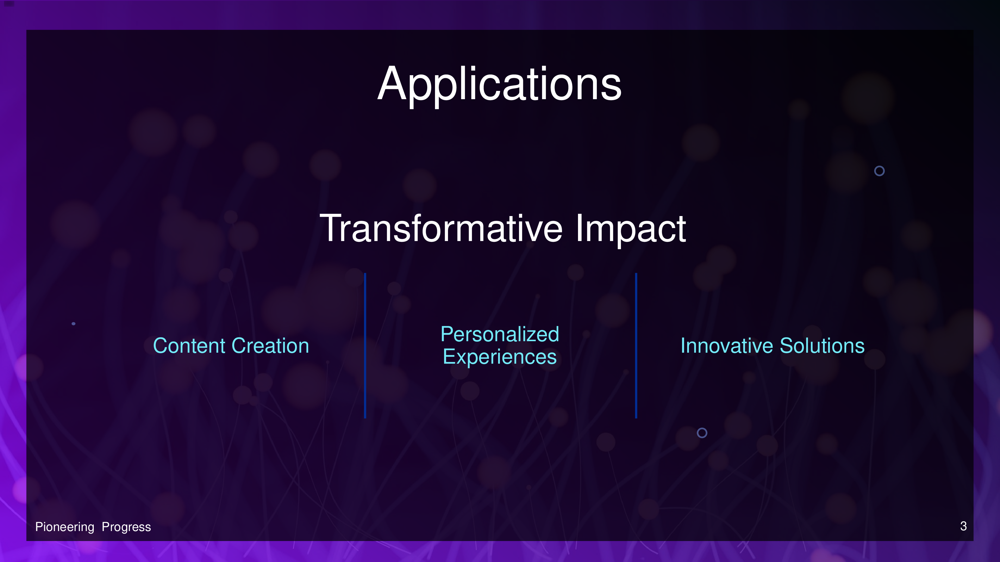

AI is like a muse: composing music, writing stories, and creating digital art,
merging human creativity with machine intelligence. For personalized
experiences, AI tailors your digital world, recommending and adapting to your
unique tastes. In innovation, AI is the visionary, predicting outcomes and
crafting solutions for global issues. These applications of AI are reshaping our
future, bound only by our imagination.




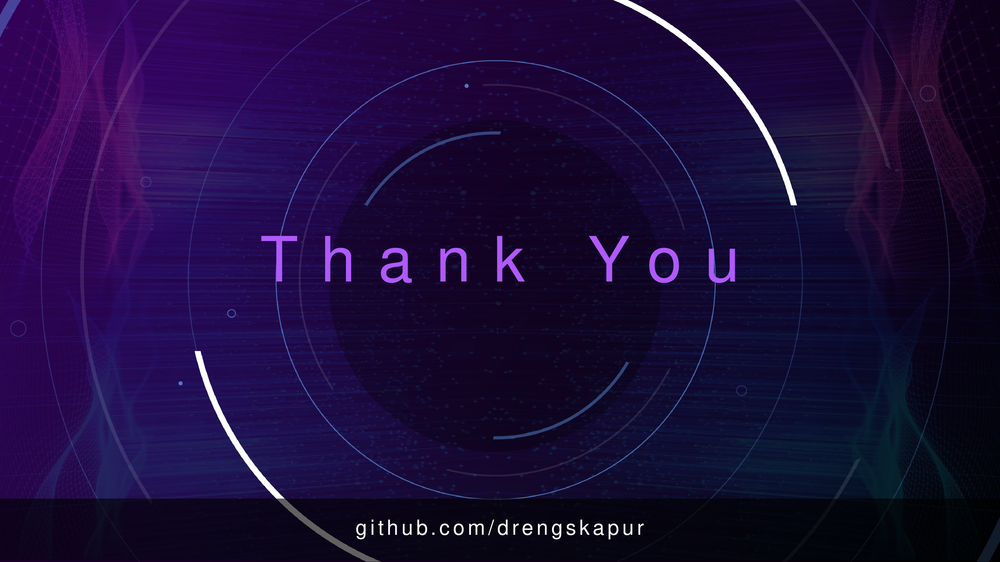

Thank you. We extend our heartfelt gratitude for joining us. Until next time,
take care and stay curious.




In [ ]:
# @title CONVERT POWERPOINT TO VIDEOCLIPS {display-mode:"form"}
# HANDLE DEPENDENCIES
!apt-get install -qq --yes --no-install-recommends ffmpeg ghostscript imagemagick libreoffice poppler-utils ure-java
!python3 -m pip install -qqq --progress-bar off --no-cache-dir ffmpeg-python pdf2image

# CONVERT POWERPOINT TO PDF
!libreoffice --headless --convert-to pdf "{pptx_assets_dir}" --outdir "{assets_dir}"
pdf_path = pptx_assets_dir.replace('.pptx', '.pdf')

# CONVERT PDF TO IMAGES
!sed -i '/<policy domain="coder" rights="none" pattern="PDF" \/>/c\<policy domain="coder" rights="read|write" pattern="PDF" \/>' /etc/ImageMagick-6/policy.xml
!convert -density 300 "{pdf_path}" "{images_dir}/image.png"

# CREATE SILENCE FOR BRIEF PAUSE BETWEEN SLIDES
silence_file = os.path.join(voiceovers_dir, "silence.mp3")
!ffmpeg -y -loglevel error -f lavfi -i anullsrc=channel_layout=mono:sample_rate=44100 -t 1 "{silence_file}"

# HANDLE DEPENDENCIES FOR PREVIEW
from IPython.display import Audio, clear_output, display, Image
import textwrap
format_text = lambda text: '\n'.join(textwrap.wrap(text, width=80))

# GENERATE ASSETS
clear_output(wait=True)
for index, slide in enumerate(presentation.slides):

    # GET NOTE FROM SLIDE
    note = slide.notes_slide.notes_text_frame.text.strip() if slide.notes_slide and slide.notes_slide.notes_text_frame else ''

    # GENERATE AUDIO
    voiceover_file = os.path.join(voiceovers_dir, f"voiceover-{index}.mp3")
    combined_voiceover_file = os.path.join(voiceovers_dir, f"combined-voiceover-{index}.mp3")
    if note:

        # RUN TEXT-TO-SPEECH FOR NOTE
        response = client.audio.speech.create(model="tts-1", voice=VOICE, input=note)
        with open(voiceover_file, "wb") as file:
            file.write(response.content)

        # ADD BRIEF PAUSE BEFORE AND AFTER EACH VOICEOVER
        !ffmpeg -y -loglevel error -i "{silence_file}" -i "{voiceover_file}" -i "{silence_file}" -filter_complex "[0:a][1:a][2:a]concat=n=3:v=0:a=1[a]" -map "[a]" "{combined_voiceover_file}"

    else:
        # IF NO NOTE, ADD BRIEF SILENCE
        shutil.copyfile(silence_file, combined_voiceover_file)

    # GENERATE VIDEO CLIP
    image_file_path = os.path.join(images_dir, f"image-{index}.png")
    video_clip_path = os.path.join(videoclips_dir, f"videoclip-{index}.mp4")
    !ffmpeg -y -loglevel error -loop 1 -i "{image_file_path}" -i "{combined_voiceover_file}" -c:v libx264 -tune stillimage -c:a aac -b:a 128k -vf "scale='iw-mod(iw,2)':'ih-mod(ih,2)',format=yuv420p" -shortest "{video_clip_path}"

    # DISPLAY PREVIEW
    display(Image(filename=image_file_path, width=320, height=180))
    display(Audio(filename=combined_voiceover_file))
    if note:
        formatted_notes = format_text(note)
        print(formatted_notes)
    print("\n" + "="*80 + "\n")



In [ ]:
# Write the correct file paths to concat_file
concat_file_path = os.path.join(videoclips_dir, "concat_list.txt")
with open(concat_file_path, "w") as concat_file:
    for index in range(len(presentation.slides)):
        video_clip_name = f"videoclip-{index}.mp4"
        video_clip_path = os.path.abspath(os.path.join(videoclips_dir, video_clip_name))
        concat_file.write(f"file '{video_clip_path}'\n")

# Combine video clips to assemble the final video
final_video_name = os.path.splitext(pptx_assets_dir)[0] + ".mp4"
final_video_path = os.path.abspath(final_video_name)
!ffmpeg -y -loglevel error -f concat -safe 0 -i "{concat_file_path}" -r 30 -c:v libx264 -preset fast -crf 22 "{final_video_path}"


In [ ]:
# @title DOWNLOAD VIDEO {display-mode:"form"}
files.download(final_video_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>